In [1]:
##############
### Import ###
##############

import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
matplotlib.rcParams.update({'font.size': 25})

from scipy.optimize import curve_fit

import numpy as np
import astropy
from astropy.io import fits
from astropy.table import Table
from scipy.interpolate import InterpolatedUnivariateSpline
import warnings
warnings.filterwarnings('ignore')
# from scipy.optimize import curve_fit
from tqdm import tqdm_notebook

In [2]:
### Import Age Code

import sys 
sys.path.append('/Users/joshuapovick/Desktop/Research/LMC_Ages/Age_Fitting')
import agefit
import importlib
importlib.reload(agefit)
from agefit.aetas import *

# Cardelli Extinction

In [36]:
leff = {'BP':0.5387,'G':0.6419,'RP':0.7667,'J':1.2345,'H':1.6393,'K':2.1757}
def cardelli_a(x):
    '''
    a(x) function from Cardelli et al. 1989
    
    Input:
    -----
        x: effective wavelength in units of 1/micron
        
    Output:
    ------
        a: a function value  
    '''
    if 0.3 <= x < 1.1:
        a = 0.574*(x**1.61)
        return a
    
    elif 1.1 <= x < 3.3:
        y = x - 1.82
        a = (1.+0.17699*y-0.50477*(y**2)-0.02427*(y**3)+0.72085*(y**4)+
                0.01979*(y**5)-0.77530*(y**6)+0.32999*(y**7))
        return a
    
    elif 3.3 <= x < 8.0:
        if x < 5.9:
            a = 1.752-0.136*x-0.104/((x-4.67)**2+0.341)
            return a
        
        else:
            fa = -0.04473*((x-5.9)**2)+0.1207*((x-5.9)**3)
            a = 1.752-0.136*x-0.104/((x-4.67)**2+0.341)+fa
            return a       
    
def cardelli_b(x):
    '''
    b(x) function from Cardelli et al. 1989
    
    Input:
    -----
        x: effective wavelength in units of 1/micron
        
    Output:
    ------
        b: b function value 
    '''
    if 0.3 <= x < 1.1:
        b = -0.527*(x**1.61)
        return b
    
    elif 1.1 <= x <= 3.3:
        y = x - 1.82
        b = (1.41338*y+2.28305*(y**2)+1.07233*(y**3)-5.38434*(y**4)-
                0.62251*(y**5)+5.30260*(y**6)-2.09002*(y**7))
        return b
    
    elif 3.3 <= x < 8.0:
        if x < 5.9:
            b = -3.090+1.825*x+1.206/((x-4.62)**2+0.263)
            return b
        
        else:
            fb = 0.2130*((x-5.9)**2)+0.1207*((x-5.9)**3)
            b = -3.090+1.825*x+1.206/((x-4.62)**2+0.263)+fb
            return b
    
def cardelli_alav(wave,rv):
    '''
    Calculate A\lambda/Av
    
    Inputs:
    ------
        wave: effective wavelength in units of micron
        rv: Rv value (=Av/E(B_V))
        
    Output:
    ------
        alav: A\lambda/Av
    '''
    x=1/wave
    alav = cardelli_a(x)+cardelli_b(x)/rv
    return alav

ejk_ak = (cardelli_alav(leff['J'],3.1)-cardelli_alav(leff['K'],3.1))/cardelli_alav(leff['K'],3.1)
ebv_ak = (cardelli_alav(0.445,3.1)-cardelli_alav(0.551,3.1))/cardelli_alav(leff['K'],3.1)

def closest(data,value):
    '''
    Find nearest value in array to given value
        
    Inputs:
    ------
        data: data to search through 
        value: value of interest
    '''
        
    data = np.asarray(data)
    return data[(np.abs(np.subtract(data,value))).argmin()]

# PARSEC Isochrones

In [3]:
### massive
massive = fits.getdata('/Users/joshuapovick/Desktop/Research/parsec/parsec_massive.fits.gz',0)
massive = Table(massive[np.where(massive['label']==3.0)])
massive['index'] = np.arange(len(massive))
massive = massive[np.argsort(massive['logAge'])]
massive = massive['index','MH','logAge','logTe','logg','Gmag','G_BPmag','G_RPmag','Jmag','Hmag','Ksmag']

# Globular Clusters

In [4]:
### GCS Data
gcs = fits.getdata('/Users/joshuapovick/Desktop/Research/fits/allStar-r13-l33-58932beta_apa_dist_galvel_gc.fits.gz')
gcs = Table(gcs[np.where((gcs['LOGG']>0.0)&(gcs['FE_H']>-9999.0)&(np.isfinite(gcs['FE_H'])==True))])
gcs = gcs[np.where(gcs['CLUSTER']=='M22')]

### DR17
dr17 = fits.getdata('/Users/joshuapovick/Desktop/Research/fits/allStarLite-dr17-synspec.fits.gz')
_, gcs_ind, dr17_ind = np.intersect1d(gcs['APOGEE_ID'], dr17['APOGEE_ID'], return_indices=True)

gcsdr17 = dr17[dr17_ind]
gcs = gcs[gcs_ind]

# gcs_clus = 'M22' #np.unique(gcs['CLUSTER'])

In [5]:
m22_medfeh = np.nanmedian(gcsdr17['FE_H'])
m22_harfeh = -1.70 # dex
m22_vanfeh = -1.70 # dex
m22_hardist = 3200. # kpc  
m22_vanage = 12.5 # Gyr

Harris-APOGEE: -0.006900024414062456
VandenBerg-APOGEE: -0.006900024414062456
Overall: -0.006900024414062456


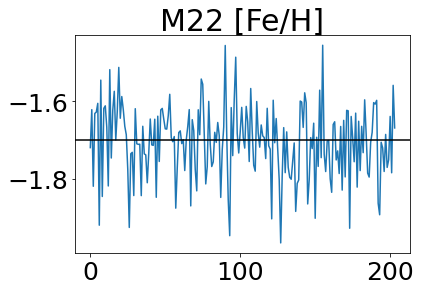

In [43]:
# gcs_dist = 999999.0*np.ones(len(gcs))
# for i in gcs:
#     gcs_dist = m22_hardist 

print('Harris-APOGEE:',np.median(m22_harfeh-m22_medfeh))
print('VandenBerg-APOGEE:',np.median(m22_vanfeh-m22_medfeh))
print('Overall:',np.median([np.median(m22_harfeh-m22_medfeh),np.median(m22_vanfeh-m22_medfeh)]))

m22_shiftfeh = 999999*np.ones(len(gcsdr17))
for i in range(len(gcsdr17)):
    # replace [Fe/H] with shifted median cluster [Fe/H] if bad value
    if np.isfinite(gcsdr17['FE_H'][i])==False:
        m22_shiftfeh[i] = (np.nanmedian(gcs['FE_H'])+
                           np.median([np.median(m22_harfeh-m22_medfeh),np.median(m22_vanfeh-m22_medfeh)]))
    # shift [Fe/H] to be in line with literature
    else:
        m22_shiftfeh[i] = (gcsdr17['FE_H'][i]+
                           np.median([np.median(m22_harfeh-m22_medfeh),np.median(m22_vanfeh-m22_medfeh)]))
        
plt.plot(m22_shiftfeh)
plt.title(r'M22 [Fe/H]')
plt.axhline(-1.70,c='k',label='Median [Fe/H]');

# Gaia Errors

In [7]:
from scipy.stats import binned_statistic
gaiaedr3 = fits.getdata('/Users/joshuapovick/Desktop/Research/gaia/GAIAEDR3allStar.fits.gz')

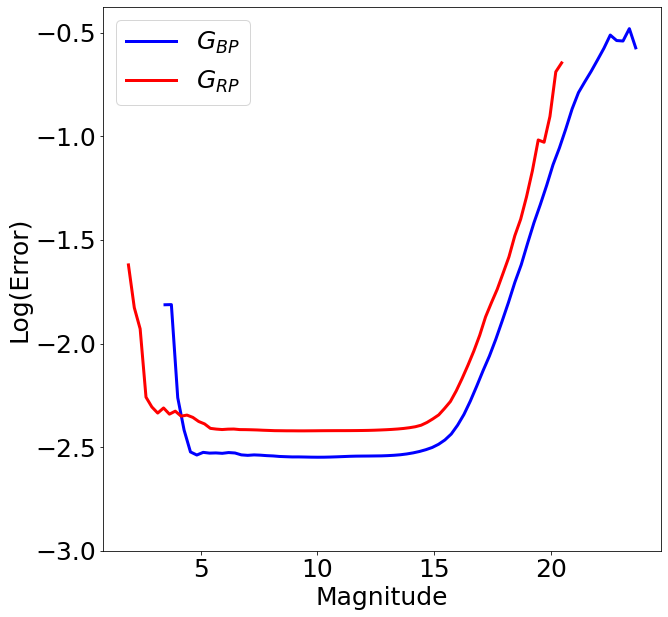

In [8]:
binnum = 75

### BP
bp_fin = np.where(np.isfinite(gaiaedr3['phot_bp_mean_mag'])==True)

bpmin = min(gaiaedr3['phot_bp_mean_mag'][bp_fin])
bpmax = max(gaiaedr3['phot_bp_mean_mag'][bp_fin])

bpdiff = bpmax-bpmin
bpfluxerr = (2.5*0.434)/gaiaedr3['phot_bp_mean_flux_over_error'][bp_fin]
bpmagerr = np.sqrt((bpfluxerr)**2+0.0027901700**2)

bpbin ,_,_ = binned_statistic(gaiaedr3['phot_bp_mean_mag'][bp_fin],np.log10(bpmagerr),'median',bins=binnum)

### RP 
rp_fin = np.where(np.isfinite(gaiaedr3['phot_rp_mean_mag'])==True)

rpmin = min(gaiaedr3['phot_rp_mean_mag'][rp_fin])
rpmax = max(gaiaedr3['phot_rp_mean_mag'][rp_fin])

rpdiff = rpmax-rpmin
rpfluxerr = (2.5*0.434)/gaiaedr3['phot_rp_mean_flux_over_error'][rp_fin]
rpmagerr = np.sqrt((rpfluxerr)**2+0.0037793818**2)

rpbin ,_,_ = binned_statistic(gaiaedr3['phot_rp_mean_mag'][rp_fin],np.log10(rpmagerr),'median',bins=binnum)

### Plot
plt.figure(figsize=[10,10])
plt.plot(np.arange(bpmin,bpmax,bpdiff/binnum),bpbin,lw=3.0,c='blue',label=r'$G_{BP}$')
plt.plot(np.arange(rpmin,rpmax,rpdiff/binnum),rpbin,lw=3.0,c='red',label=r'$G_{RP}$')
plt.legend()
plt.ylim(bottom=-3.0)
plt.xlabel('Magnitude')
plt.ylabel('Log(Error)');

In [9]:
bperrfunc = InterpolatedUnivariateSpline(np.arange(bpmin,bpmax,bpdiff/binnum),bpbin)
rperrfunc = InterpolatedUnivariateSpline(np.arange(rpmin,rpmax,rpdiff/binnum),rpbin)

bperr = 10**bperrfunc(gcsdr17['GAIAEDR3_PHOT_BP_MEAN_MAG'])
rperr = 10**rperrfunc(gcsdr17['GAIAEDR3_PHOT_RP_MEAN_MAG'])

# Run Code and Make Diagnostic Plots for all stars in M22

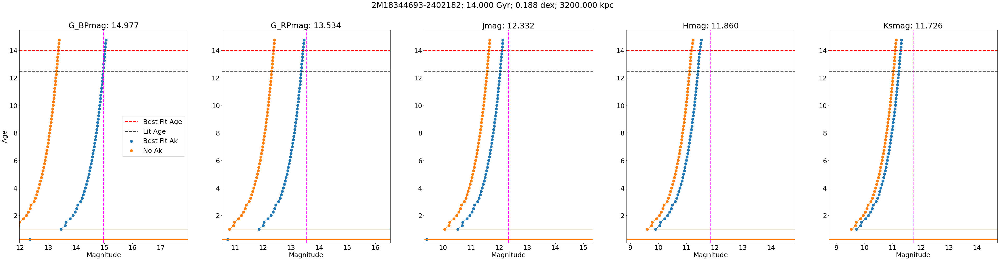

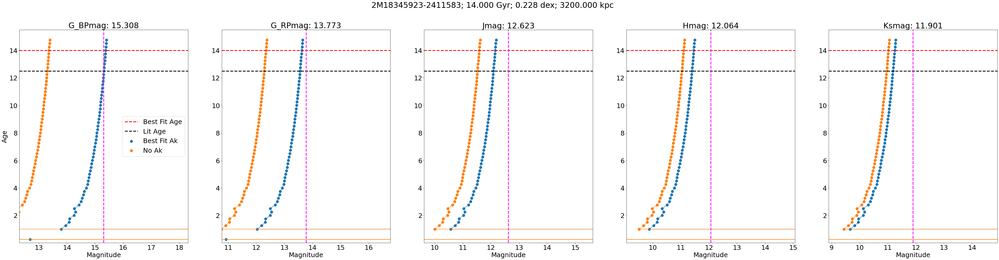

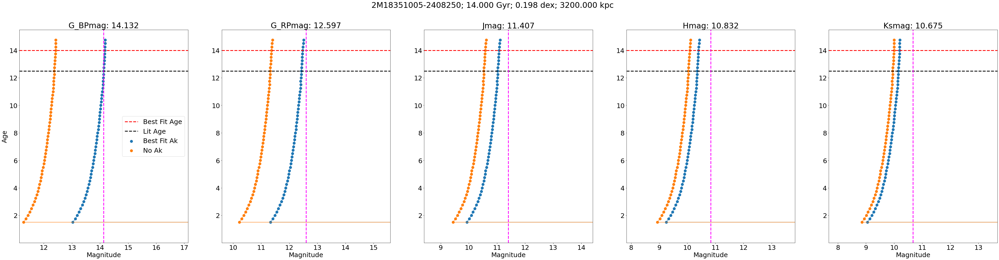

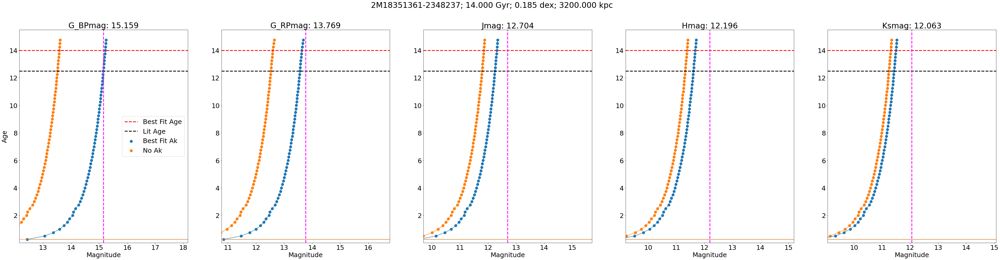

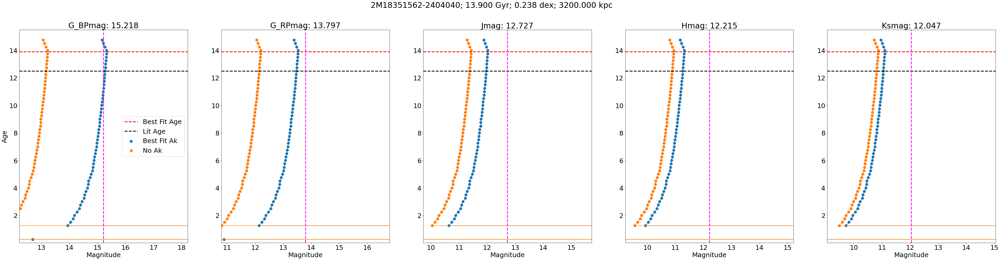

...

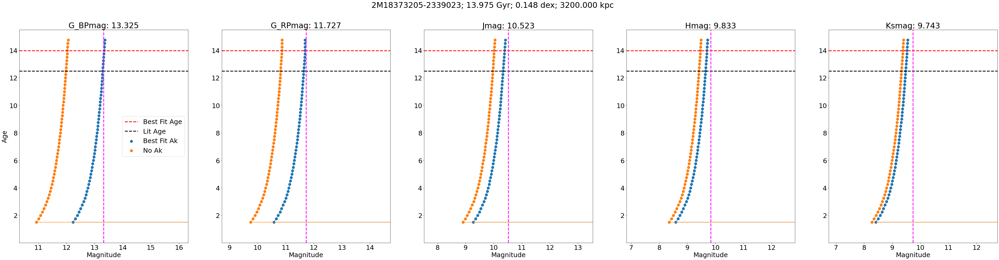

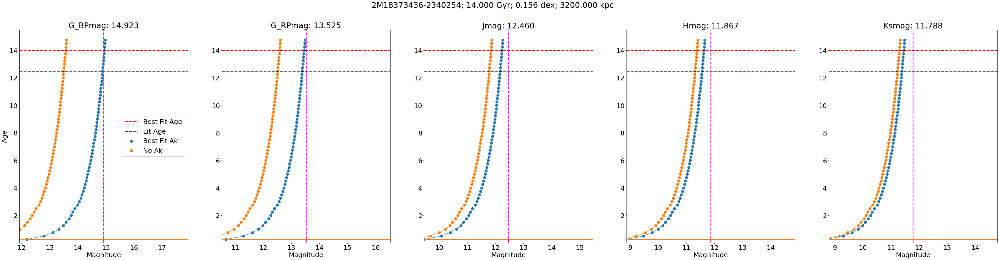

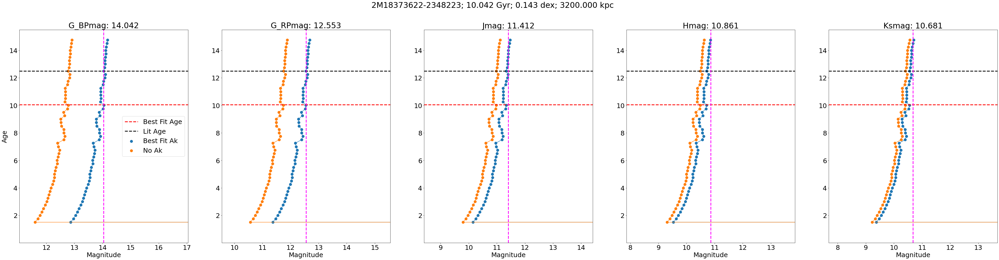

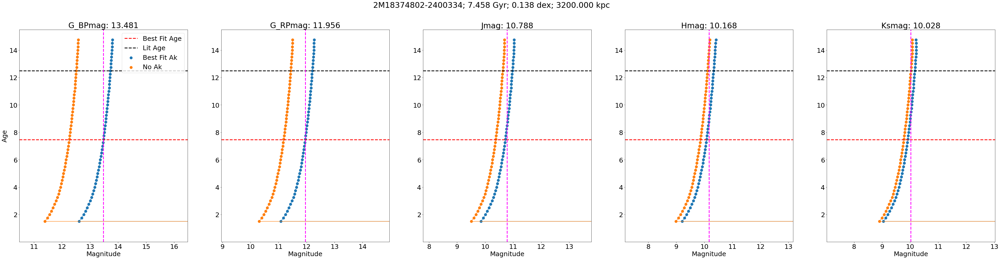

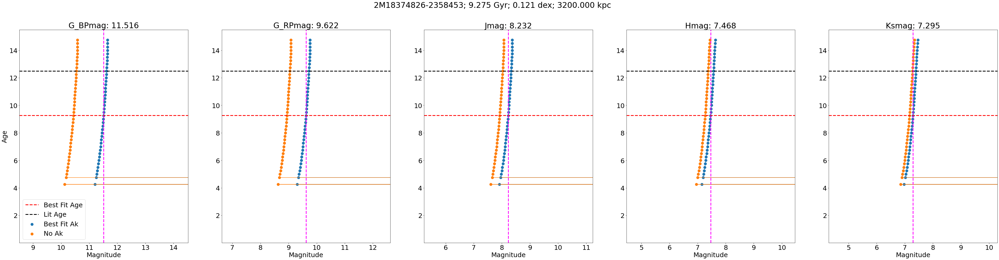

ValueError: Axis limits cannot be NaN or Inf

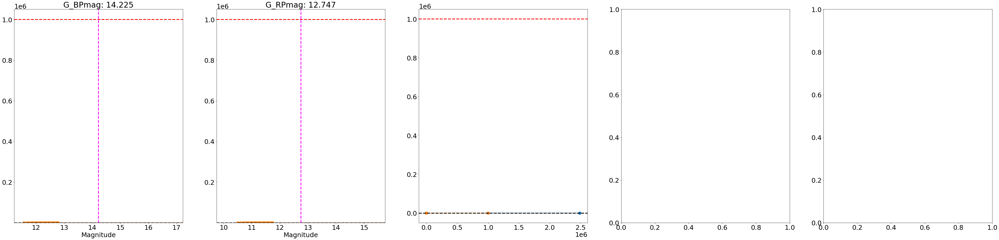

In [10]:
bf_params = -999999.0*np.ones((len(gcs),2))
bf_params_err = -999999.0*np.ones((len(gcs),2))
for i in tqdm_notebook(range(len(gcs))):
    cnalpha = np.array([gcsdr17['C_FE'][i],gcsdr17['N_FE'][i],gcsdr17['O_FE'][i],gcsdr17['MG_FE'][i],
                        gcsdr17['SI_FE'][i],gcsdr17['S_FE'][i],gcsdr17['CA_FE'][i],gcsdr17['TI_FE'][i]])
    
    phots = np.array([gcsdr17['GAIAEDR3_PHOT_BP_MEAN_MAG'][i],gcsdr17['GAIAEDR3_PHOT_RP_MEAN_MAG'][i],
                      gcsdr17['J'][i],gcsdr17['H'][i],gcsdr17['K'][i]])
    
    phots_err = np.array([bperr[i],rperr[i],gcsdr17['J'][i],gcsdr17['H'][i],gcsdr17['K'][i]])
    
    CalcAge = AetasStellae(gcsdr17['TEFF'][i],m22_shiftfeh[i],cnalpha,phots,phots_err,3200,massive)
    best_fit_params,best_fit_params_err = CalcAge.fit()
    
    bf_params[i] = best_fit_params
    bf_params_err[i] = best_fit_params_err
    
    CalcAge.diagnostic(best_fit_params,star_name=gcsdr17['APOGEE_ID'][i],lit_age=12.5,
                       filename='../plots/m22diagnostic/{}diagnostic.png'.format(gcsdr17['APOGEE_ID'][i]))

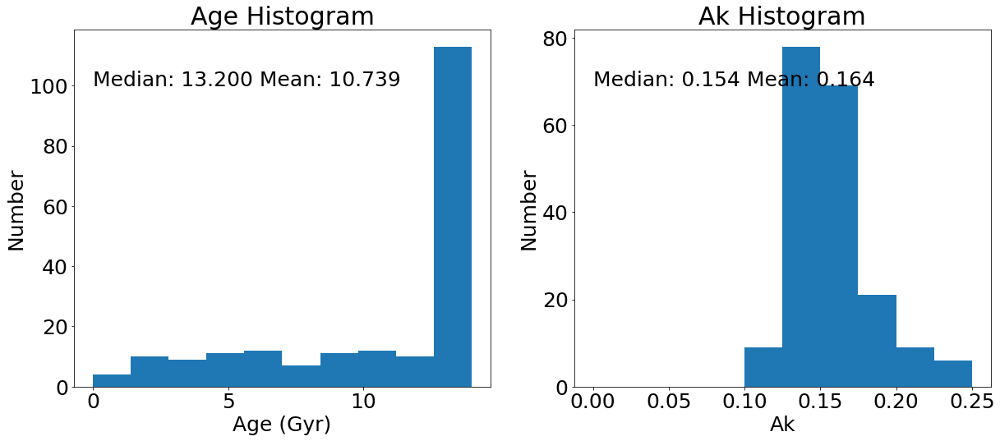

In [33]:
good = np.where((bf_params[:,0]>-1.)&(bf_params[:,0]<15.))

plt.figure(figsize=[20,8])
plt.subplot(121)
plt.hist(bf_params[:,0],range=(0,14))
plt.text(0,100,'Median: {:.3f} Mean: {:.3f}'.format(np.median(bf_params[:,0][good]),np.mean(bf_params[:,0][good])))
plt.title(r'Age Histogram')
plt.xlabel(r'Age (Gyr)')
plt.ylabel(r'Number')
plt.subplot(122)
plt.hist(bf_params[:,1],range=(0,0.25))
plt.text(0,69,'Median: {:.3f} Mean: {:.3f}'.format(np.median(bf_params[:,1][good]),np.mean(bf_params[:,1][good])))
plt.title(r'Ak Histogram')
plt.xlabel(r'Ak')
plt.ylabel(r'Number')
plt.savefig('../plots/M22AgeAk.pdf',bbox_inches='tight')
plt.show()

In [12]:
print(np.median(bf_params[:,0]))
print(np.median(bf_params[:,1]))

13.209140653266914
0.15426919102048264


In [79]:
ebprp_ak = ((cardelli_alav(leff['BP'],3.1)-cardelli_alav(leff['RP'],3.1))/cardelli_alav(leff['K'],3.1))
ebprp_ak

3.2580489086437394

In [89]:
ebprp_jk = ((cardelli_alav(leff['BP'],3.1)-cardelli_alav(leff['RP'],3.1))/
            (cardelli_alav(leff['J'],3.1)-cardelli_alav(leff['K'],3.1)))

ebprp_bv = ((cardelli_alav(leff['BP'],3.1)-cardelli_alav(leff['RP'],3.1))/
            (cardelli_alav(0.445,3.1)-cardelli_alav(0.551,3.1)))


print('Harris',0.34*ebprp_bv)

# Variable stars in the VVV globular clusters. II. NGC 6441, NGC 6569, NGC 6626 (M 28), NGC 6656 (M 22), 2MASS-GC 02, and Terzan 10
print('Alonso-García',0.18*ebprp_ak)#Javier Alonso-García et al. 2021 

print('Calculated',np.median(bf_params[:,1][good])*ebprp_ak)

Harris 0.41384616669782165
Alonso-García 0.586448803555873
Calculated 0.5010493760265271


In [90]:
np.median(m22_shiftfeh)

-1.6970000386238098

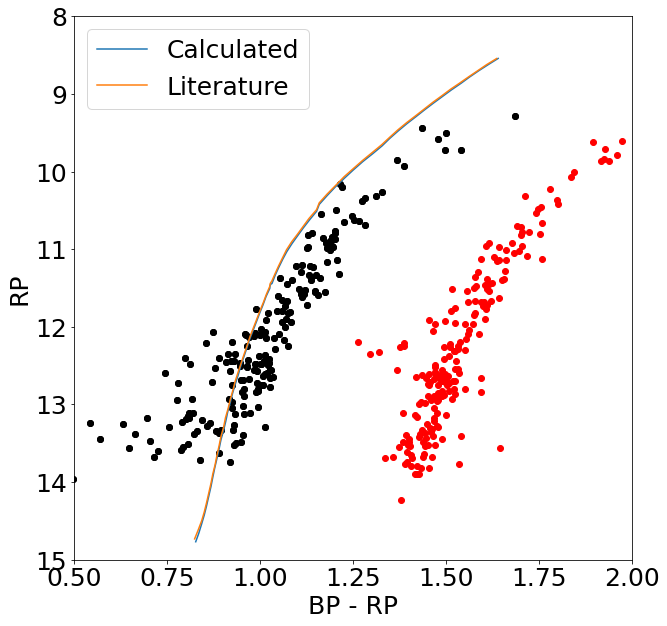

In [88]:
calc_iso = np.where(
    (massive['logAge']==closest(massive['logAge'],np.log10(np.median(bf_params[:,0][good])*10**9)))&
    (massive['MH']==closest(massive['MH'],np.median(m22_shiftfeh))))
calc_sort = np.argsort(massive['logTe'][calc_iso])

lite_iso = np.where(
    (massive['logAge']==closest(massive['logAge'],np.log10(12.5*10**9)))&
    (massive['MH']==closest(massive['MH'],-1.70)))
lite_sort = np.argsort(massive['logTe'][lite_iso])

plt.figure(figsize=[10,10])
# plt.subplot(121)
plt.plot((massive['G_BPmag']-massive['G_RPmag'])[calc_iso][calc_sort],
         massive['G_RPmag'][calc_iso][calc_sort]+5.0*np.log10(3200)-5.0,label='Calculated')
plt.plot((massive['G_BPmag']-massive['G_RPmag'])[lite_iso][lite_sort],
         massive['G_RPmag'][lite_iso][lite_sort]+5.0*np.log10(3200.)-5.0,label='Literature')

plt.legend()

plt.scatter(gcsdr17['GAIAEDR3_PHOT_BP_MEAN_MAG']-gcsdr17['GAIAEDR3_PHOT_RP_MEAN_MAG']-ebprp_ak*bf_params[:,1],
            gcsdr17['GAIAEDR3_PHOT_RP_MEAN_MAG']-bf_params[:,1],c='k')
plt.scatter(gcsdr17['GAIAEDR3_PHOT_BP_MEAN_MAG']-gcsdr17['GAIAEDR3_PHOT_RP_MEAN_MAG']-ebprp_ak*bf_params[:,1],
            gcsdr17['GAIAEDR3_PHOT_RP_MEAN_MAG']-bf_params[:,1],c='k')
plt.scatter(gcsdr17['GAIAEDR3_PHOT_BP_MEAN_MAG']-gcsdr17['GAIAEDR3_PHOT_RP_MEAN_MAG'],
            gcsdr17['GAIAEDR3_PHOT_RP_MEAN_MAG'],c='r')

plt.xlim(0.5,2.0)
plt.ylim(8,15)
plt.gca().invert_yaxis()

plt.xlabel(r'BP - RP')
plt.ylabel(r'RP')

plt.savefig('../plots/M22GaiaCMD.pdf',bbox_inches='tight');

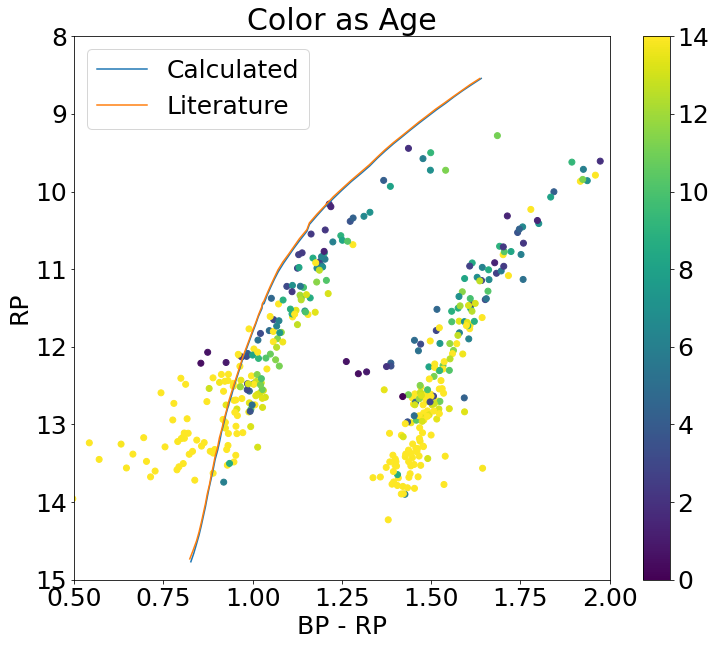

In [103]:
plt.figure(figsize=[12,10])
# plt.subplot(121)
plt.plot((massive['G_BPmag']-massive['G_RPmag'])[calc_iso][calc_sort],
         massive['G_RPmag'][calc_iso][calc_sort]+5.0*np.log10(3200)-5.0,label='Calculated')
plt.plot((massive['G_BPmag']-massive['G_RPmag'])[lite_iso][lite_sort],
         massive['G_RPmag'][lite_iso][lite_sort]+5.0*np.log10(3200.)-5.0,label='Literature')

plt.legend()

plt.scatter(gcsdr17['GAIAEDR3_PHOT_BP_MEAN_MAG']-gcsdr17['GAIAEDR3_PHOT_RP_MEAN_MAG']-ebprp_ak*bf_params[:,1],
            gcsdr17['GAIAEDR3_PHOT_RP_MEAN_MAG']-bf_params[:,1],c=bf_params[:,0],
            vmax=14,vmin=0)
plt.scatter(gcsdr17['GAIAEDR3_PHOT_BP_MEAN_MAG']-gcsdr17['GAIAEDR3_PHOT_RP_MEAN_MAG'],
            gcsdr17['GAIAEDR3_PHOT_RP_MEAN_MAG'],c=bf_params[:,0],vmax=14,vmin=0)
plt.colorbar()

plt.xlim(0.5,2.0)
plt.ylim(8,15)
plt.gca().invert_yaxis()

plt.xlabel(r'BP - RP')
plt.ylabel(r'RP')
plt.title(r'Color as Age')

plt.savefig('../plots/M22GaiaCMD.png',bbox_inches='tight',dpi=300)
plt.show()

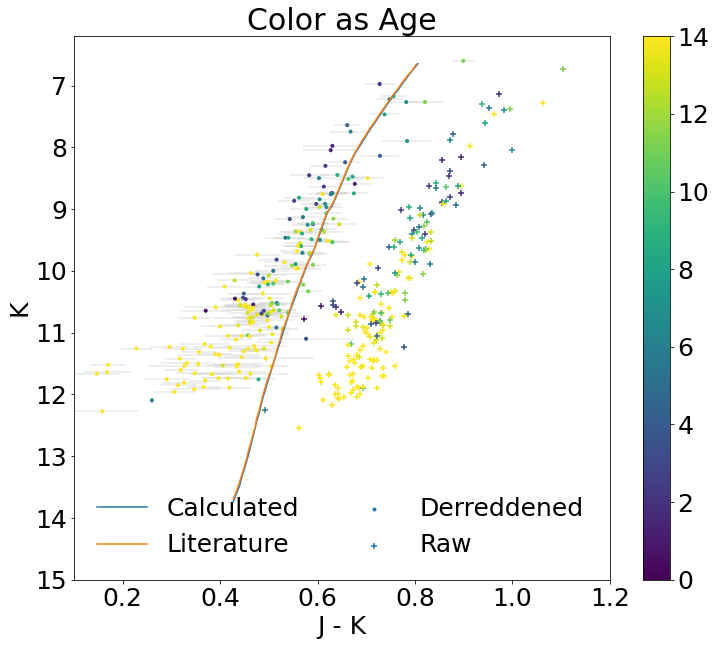

In [154]:
jk_err = np.sqrt(gcsdr17['J_ERR']**2+gcsdr17['K_ERR']**2+(ejk_ak*bf_params_err[:,1])**2)
k_err = np.sqrt(gcsdr17['K_ERR']**2+bf_params_err[:,1]**2)

plt.figure(figsize=[12,10])
# plt.subplot(121)
plt.plot((massive['Jmag']-massive['Ksmag'])[calc_iso][calc_sort],
         massive['Ksmag'][calc_iso][calc_sort]+5.0*np.log10(3200)-5.0,label='Calculated')
plt.plot((massive['Jmag']-massive['Ksmag'])[lite_iso][lite_sort],
         massive['Ksmag'][lite_iso][lite_sort]+5.0*np.log10(3200.)-5.0,label='Literature')

plt.legend()

plt.scatter(gcsdr17['J']-gcsdr17['K']-ejk_ak*bf_params[:,1],gcsdr17['K']-bf_params[:,1],c=bf_params[:,0],
            vmax=14,vmin=0,label='Derreddened',zorder=2,marker='.')
plt.scatter(gcsdr17['J']-gcsdr17['K'],gcsdr17['k'],c=bf_params[:,0],vmax=14,vmin=0,marker='+',
            label='Raw',zorder=0)
plt.colorbar()

plt.errorbar(gcsdr17['J']-gcsdr17['K']-ejk_ak*bf_params[:,1],gcsdr17['K']-bf_params[:,1],xerr=jk_err,
             yerr=k_err,c='lightgrey',ls=' ',zorder=1,alpha=0.5)

plt.legend(ncol=2,frameon=False)

plt.xlim(0.1,1.2)
plt.ylim(6.2,15)
plt.gca().invert_yaxis()

plt.xlabel(r'J - K')
plt.ylabel(r'K')
plt.title(r'Color as Age')

plt.savefig('../plots/M22_2MASSCMD.png',bbox_inches='tight',dpi=300)
plt.show()

In [137]:
ejk_ak*bf_params_err[:,1]

array([ 1.88185512e-03,  2.57006792e-03,  5.83958549e-04,  9.73177839e-04,
        6.44012495e-04,  3.66976603e-03,  1.88173940e-03,  5.25982155e-03,
        2.30671792e-03,  2.19475483e-03,  1.54073261e-03,  4.94189839e-02,
        1.30575890e-03,  3.61530585e-03,  4.96821330e-03,  1.04616880e-03,
        1.03948312e-03,  2.68793598e-03,  1.46154195e-03,  1.66594120e-03,
        2.31478964e-03,  1.75969394e-03,  1.55489289e-02,  7.13461444e-04,
        6.13966656e-03,  1.86150603e-03,  1.76745923e-03,  1.39966610e-03,
        2.12224737e-03,  1.60662241e-03,  2.22571277e-03,  1.15120195e-03,
        4.47056974e-04,  2.10914912e-03,  1.83410958e-03,  2.01252843e-03,
        1.92096955e-03,  1.14703822e-03,  2.74780755e-03,  2.49221546e-03,
        1.98038375e-03,  1.62402390e-03,  1.54362382e-03,  8.09384354e-04,
        1.49851911e-03,  2.30008420e-03,  1.67478553e-03,  1.18997729e-03,
        4.69863563e-03,  2.18883707e-03,  4.77894726e-04,  9.75173737e-04,
        2.20120159e-03,  

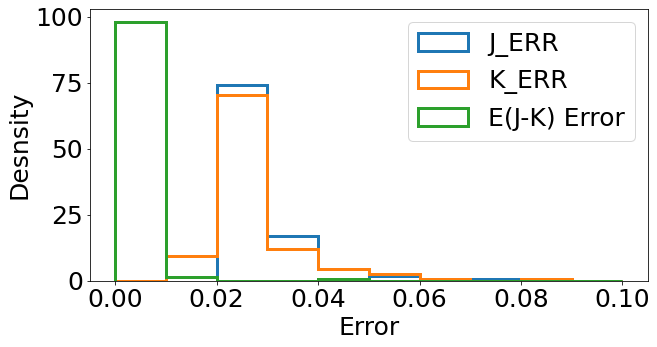

In [149]:
plt.figure(figsize=[10,5])
plt.hist(gcsdr17['J_ERR'],range=(0,0.1),density=True,histtype='step',lw=3.0,label='J_ERR')
plt.hist(gcsdr17['K_ERR'],range=(0,0.1),density=True,histtype='step',lw=3.0,label='K_ERR')
plt.hist(ejk_ak*bf_params_err[:,1],range=(0,0.1),density=True,histtype='step',lw=3.0,label='E(J-K) Error')
plt.legend()
plt.xlabel('Error')
plt.ylabel('Desnsity')
plt.savefig('../plots/M22ErrorHistograms.png',bbox_inches='tight')

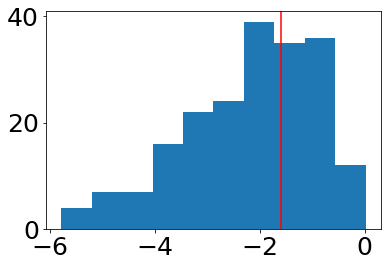

In [107]:
plt.hist(gcsdr17['K']-5.0*np.log10(3200.)+5.0)
plt.axvline(-1.60,c='r')

(array([ 0.,  0., 87., 90., 15.,  3.,  3.,  1.,  0.,  0.]),
 array([0.  , 0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 ]),
 <a list of 10 Patch objects>)

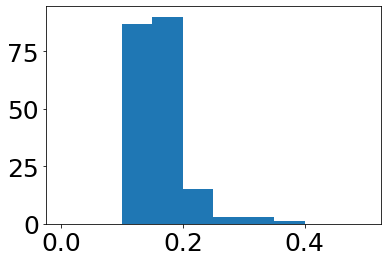

In [69]:
plt.hist(bf_params[:,1],range=(0,0.5))

In [18]:
m22_salfeh = 999999.0*np.ones(len(gcs))

for i in tqdm_notebook(range(len(gcs))):
#     print(np.array([gcsdr17['C_FE'][i],gcsdr17['N_FE'][i],gcsdr17['O_FE'][i],gcsdr17['MG_FE'][i],
#                         gcsdr17['SI_FE'][i],gcsdr17['S_FE'][i],gcsdr17['CA_FE'][i],gcsdr17['TI_FE'][i]]))
    
#     print(np.array([gcsdr17['GAIAEDR3_PHOT_BP_MEAN_MAG'][i],gcsdr17['GAIAEDR3_PHOT_RP_MEAN_MAG'][i],
#                       gcsdr17['J'][i],gcsdr17['H'][i],gcsdr17['K'][i]]))
    
#     print(np.array([bperr[i],rperr[i],gcsdr17['J'][i],gcsdr17['H'][i],gcsdr17['K'][i]]))
    
    cnalpha = np.array([gcsdr17['C_FE'][i],gcsdr17['N_FE'][i],gcsdr17['O_FE'][i],gcsdr17['MG_FE'][i],
                        gcsdr17['SI_FE'][i],gcsdr17['S_FE'][i],gcsdr17['CA_FE'][i],gcsdr17['TI_FE'][i]])
    
    phots = np.array([gcsdr17['GAIAEDR3_PHOT_BP_MEAN_MAG'][i],gcsdr17['GAIAEDR3_PHOT_RP_MEAN_MAG'][i],
                      gcsdr17['J'][i],gcsdr17['H'][i],gcsdr17['K'][i]])
    
    phots_err = np.array([bperr[i],rperr[i],gcsdr17['J'][i],gcsdr17['H'][i],gcsdr17['K'][i]])
    
    CalcAge = AetasStellae(gcsdr17['TEFF'][i],m22_shiftfeh[i],cnalpha,phots,phots_err,3200,massive)
    m22_salfeh[i] = CalcAge.salfeh

TypeError: __init__() got an unexpected keyword argument 'verbose'

In [12]:
print('Salaris [Fe/H]',np.where(np.isfinite(m22_salfeh)==False))

Salaris [Fe/H] (array([], dtype=int64),)


In [13]:
print('BP: ',np.where(np.isfinite(gcsdr17['GAIAEDR3_PHOT_BP_MEAN_MAG'])==False))
print('RP: ',np.where(np.isfinite(gcsdr17['GAIAEDR3_PHOT_RP_MEAN_MAG'])==False))

BP:  (array([], dtype=int64),)
RP:  (array([], dtype=int64),)


In [14]:
print('J: ',np.where(np.isfinite(gcsdr17['J'])==False))
print('H: ',np.where(np.isfinite(gcsdr17['H'])==False))
print('K: ',np.where(np.isfinite(gcsdr17['K'])==False))

J:  (array([202, 203]),)
H:  (array([], dtype=int64),)
K:  (array([202, 203]),)


In [15]:
print('J_ERR: ',np.where(np.isfinite(gcsdr17['J_ERR'])==False))
print('H_ERR: ',np.where(np.isfinite(gcsdr17['H_ERR'])==False))
print('K_ERR: ',np.where(np.isfinite(gcsdr17['K_ERR'])==False))

J_ERR:  (array([ 28, 118, 202, 203]),)
H_ERR:  (array([ 28, 118, 202, 203]),)
K_ERR:  (array([ 52, 134, 202, 203]),)


In [16]:
print('TEFF: ',np.where(np.isfinite(gcsdr17['TEFF'])==False))

TEFF:  (array([ 54, 116, 147]),)


In [17]:
bf_params[0]

array([999999., 999999.])